# Network Science
## Final Project

### What happens with robustness in the presence of interdependent networks?

#### Ben Murphy 16-714-925
#### Florian Rüegsegger 16-714-737
#### Silvan Wehrli 15-703-275

## Introduction

We analyse the streetnetwork of Newyork/Manhattan in order to find where weakpoints of the system lie. In order to confirm our findings we define metrics by which we measure the speed at which cars can traverse through the network. 

- Randomly select two nodes and check how long it takes from Node A to B
- check average path length
- define metrics speed (Use edge attributes) (speedlimit, distance, time), (amount of nodes), (traffic?/real traffic data)
- simulate traffic
- compare to real traffic data
- randomly attack network in order to verify our choice of nodes
- try with other networks? Zurich?
- 


In [1]:
import networkx as nx
from networkx import read_graphml
import networkx.readwrite.gml as graph_reader
import matplotlib.pyplot as plt
plt.style.use('seaborn')
import numpy as np
from typing import List, Dict, Tuple
import seaborn as sns
import osmnx as ox
import random
from tqdm.notebook import tqdm
from collections import Counter
from scipy.special import factorial
import powerlaw
import time
import pickle
import json
from networkx.algorithms.assortativity import average_degree_connectivity, degree_pearson_correlation_coefficient
from networkx.algorithms.cluster import clustering
from networkx.algorithms.smallworld import random_reference
from networkx.algorithms import degree_centrality, closeness_centrality, betweenness_centrality, eigenvector_centrality
from scipy.stats import pearsonr, spearmanr, kendalltau
#Wheter the data set should be downloaded from the internet, must be done once.
LOAD = False

### Plotting functions

In [13]:
def plot_hist(data: List[float],label: str, xlabel: str = "", density=True, show=True):
    plt.hist(data, label=label, density=density)
    plt.xlabel(xlabel)
    plt.ylabel(f"{'density' if density else 'count'} ")
    if show:
        plt.legend()
        plt.show()
plt.rcParams.update(plt.rcParamsDefault)

## General Data

In [11]:
def clean_data(graph, key_for_removal: str) -> nx.Graph:
    
    new_graph = nx.DiGraph()
    new_graph.graph = graph.graph
    for edge in graph.edges():
        start, end = edge
        keys = graph[start][end][key_for_removal].keys()
        data = {}
        for key in keys:
            if key in ["highway","name", "lanes","maxspeed","Bridge","Tunnel", "length", "speed_kph", "travel_time"]:
                data[key] = graph[start][end][key_for_removal][key]
                if key == "length":
                    data[key] = float(data[key])
        new_graph.add_edge(start,end,**data)

    for node in graph.nodes().keys():
        for key in graph.nodes()[node].keys():
            if key in ["x", "y"]: 
                new_graph.nodes()[node][key] = float(graph.nodes()[node][key])
            elif key == "highway":
                new_graph.nodes()[node][key] = graph.nodes()[node][key]

                
    return new_graph

In [49]:
if LOAD:
    print("Downloading data")
    graph = ox.graph_from_place('Manhattan, New York City, New York, USA', network_type='drive')
    print("adding the need for speed")
    graph = ox.speed.add_edge_speeds(graph)
    graph = ox.speed.add_edge_travel_times(graph, precision=1)
    print("Writing uncleaned to file")
    ox.save_graphml(graph, "data/unclean_MA.graphml")
    print("Cleaning data")
    graph = clean_data(graph,0)
    print("write to file")
    nx.write_gml(graph,"data/cleaned_MA.gml")
graph_MA = nx.read_gml("data/cleaned_MA.gml")

adding the need for speed
Writing uncleaned to file
Cleaning data
write to file


## Data Inspection

In [106]:
uncleaned_graph_NY = ox.load_graphml("data/unclean_NY.graphml")

Let's first visualize the network. As one can see below, the network represents indeed the street network of New York!

In [45]:
graph_MA = nx.read_gml("data/cleaned_MA.gml")
graph_NY = nx.read_gml("data/cleaned_NY.gml")

In [6]:
print(f"n nodes: {len(graph_NY.nodes())}")
print(f"n edges: {len(graph_NY.edges())}")
print(f"graph is directed: {nx.is_directed(graph_NY)}")
print(f"graph weakly connected: {nx.is_weakly_connected(graph_NY)}") # Treat edges as undirected
print(f"graph strongly connected: {nx.is_strongly_connected(graph_NY)}") # Treat edges as directed

n nodes: 55366
n edges: 140022
graph is directed: True
graph weakly connected: True
graph strongly connected: False


### Component Analysis

As the network represents a street network (see figure above), one would expect that there must be at least one very big component --> almost all streets are connected, i.e. one can travel from one point to any other point in the city. Possibly, there are components with a very low size that cannot be reached (e.g. private streets). But is this actually true? Let's have a look at the distribution of sizes of strongly connected components in the network.

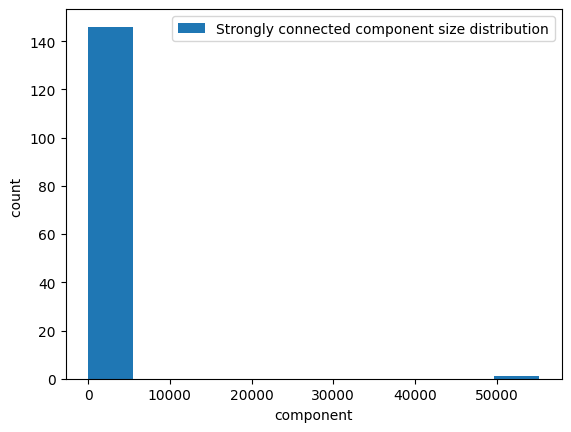

In [82]:
component_size = np.array([len(value) for index, value in enumerate(sorted(nx.strongly_connected_components(graph_NY), key=len, reverse=True))])
plot_hist(component_size, "Strongly connected component size distribution", "component", density=False)

Yes, this is indeed the case: We have a lot of small unconnected components (strong connectivity).

In [ ]:
Strongly connected components size distribution, without single components

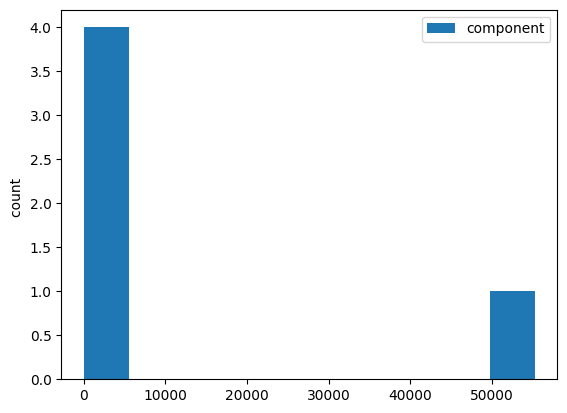

[55216     2     2     2     2     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1     1     1     1     1     1     1     1     1     1
     1     1     1]


In [84]:
plot_hist(component_size[component_size>1], "component", density=False)
print(component_size)

By removing all components with size < 2 we end up with 9 components.  
For our further analysis, we focus on the biggest component and remove all the small ones as they hardly matter.

In [59]:
largest_component = list(sorted(nx.strongly_connected_components(graph_NY), key=len, reverse=True))[0]
graph = graph.subgraph(largest_component).copy()

In [117]:
print(f"n nodes: {len(graph.nodes())}")
print(f"n edges: {len(graph.edges())}")
print(f"graph is directed: {nx.is_directed(graph)}")
print(f"graph weakly connected: {nx.is_weakly_connected(graph)}") # Treat edges as undirected
print(f"graph strongly connected: {nx.is_strongly_connected(graph)}") # Treat edges as directed

NameError: name 'graph' is not defined

### Degree Distribution

As a next step, we'll have a look at the degree distribution and which theoretical distribution this real network is similar to (relevant for the percolation / robustness analysis as this allow to make comparisons to a randomly generated network).

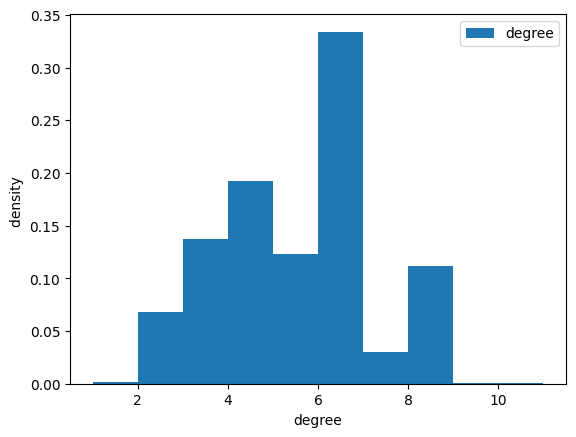

In [34]:
degrees = [i[1] for i in graph_NY.degree()]
plot_hist(degrees, "degree", "degree")

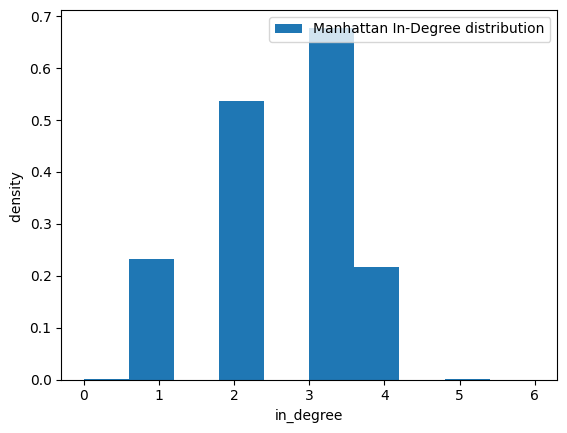

In [35]:
in_degrees = [i[1] for i in graph_NY.in_degree()]
plot_hist(in_degrees, "Manhattan In-Degree distribution", "in_degree", "in_degree")

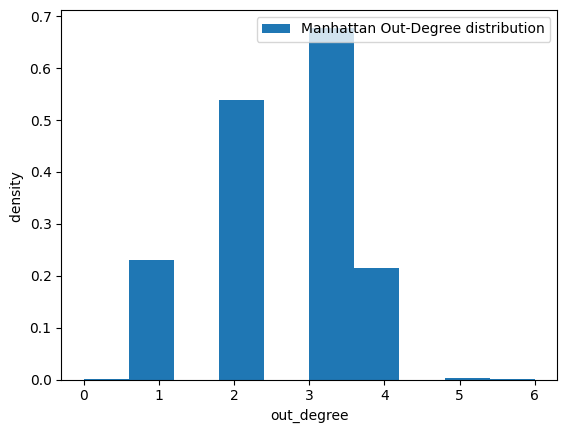

In [36]:
out_degrees = [i[1] for i in graph_NY.out_degree()]
plot_hist(out_degrees, "Manhattan Out-Degree distribution", "out_degree", "out_degree")

C:\Users\benmu\anaconda3\envs\networkscience\lib\site-packages\seaborn\axisgrid.py:2182: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


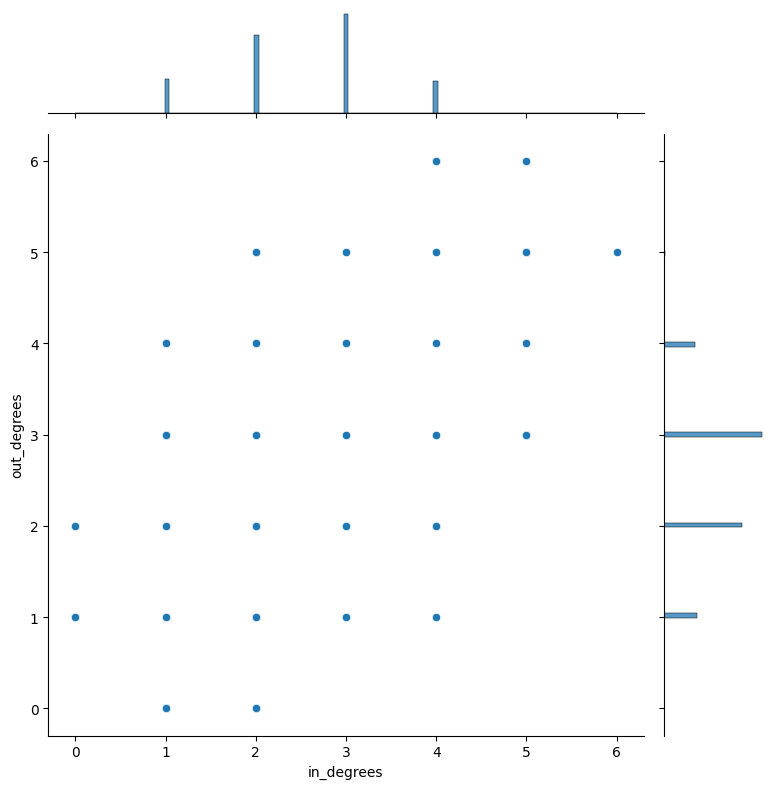

In [37]:
degrees = {
    "in_degrees":in_degrees,
    "out_degrees":out_degrees
}
sns.jointplot(x="in_degrees",y="out_degrees",data=degrees, size=8)
plt.show()

In [40]:
degrees = [i[1] for i in graph_MA.degree()]
deg_mean = np.mean(degrees)
spacing = np.linspace(np.min(degrees), np.max(degrees), np.max(degrees)-np.min(degrees))
poisson = ((deg_mean**spacing) / factorial(spacing) ) * np.exp(-deg_mean)
#poisson = np.random.poisson(spacing)
degrees = np.array(degrees)
exponential = deg_mean**-1 * np.exp(-spacing / deg_mean) 
#fit = powerlaw.Fit(degrees, verbose=False)

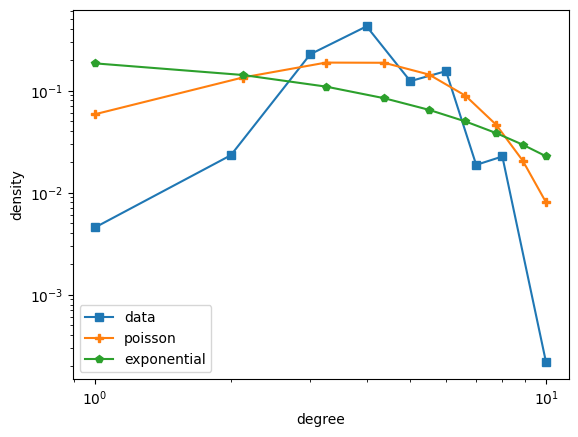

In [41]:
counts = Counter(degrees)

keys = sorted(counts.keys())
values = [counts[key] / len(degrees) for key in keys]
plt.plot(keys,values, label="data", marker = "s")
plt.plot(spacing,poisson, label="poisson", marker = 'P')
plt.plot(spacing,exponential, label="exponential", marker = 'p')
plt.xscale("log")
plt.yscale("log")
plt.xlabel("degree")
plt.ylabel("density")
plt.legend()
plt.show()

One can see that the distribution more or less follows the poisson distributon. An exception are nodes with a rather high degree. This makes sense: it is rather unlikely that there are crossings in a city with streets in many directions.

### Assortativity

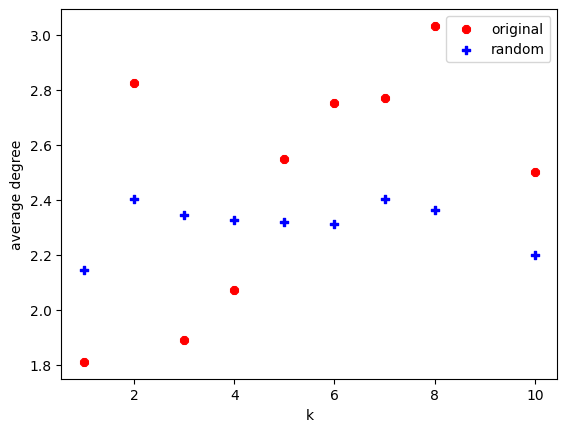

Pearson Correlation coefficient Original: 0.4254173734952055
Pearson Correlation coefficient Random: 0.0073396719346310434


In [47]:
def plot_average_degree(graph_og: nx.Graph, graph_random: nx.Graph):
    key_value_og = get_k_value(average_degree_connectivity(graph_og))
    key_value_random = get_k_value(average_degree_connectivity(graph_random))
    plt.scatter(key_value_og[0],key_value_og[1], label="original", color="r")
    plt.scatter(key_value_random[0],key_value_random[1], label="random", color="b")
    plt.xlabel("k")
    plt.ylabel("average degree")
    plt.title(f"Manhattan Knn average degree")
    plt.legend()
    plt.show()


def get_k_value(knn: dict) -> Tuple[List, List]:
    """
    return k and the average value as two sorted lists
    """
    keys = list(knn.keys())
    keys.sort()
    values = [knn[key] for key in keys]
    return keys, values


graph_NY = graph_reader.read_gml(f"data/cleaned_MA.gml")
rand_graph = nx.directed_configuration_model(dict(graph_NY.in_degree()).values(), dict(graph_NY.out_degree()).values(), seed=128)
plot_average_degree(graph_NY, rand_graph)
print(f"Pearson Correlation coefficient Original: {degree_pearson_correlation_coefficient(graph_NY)}")
print(f"Pearson Correlation coefficient Random: {degree_pearson_correlation_coefficient(rand_graph)}")

In [115]:
def plot_centralities(graph: Dict[str,nx.Graph]):
    degrees = list(degree_centrality(graph).values())
    print('degrees done')
    closenesses = list(closeness_centrality(graph).values())
    print('closeness done')
    betweennesses = list(betweenness_centrality(graph).values())
    print('betweeness done')
    eigenvectors = list(eigenvector_centrality(graph,max_iter=1000).values())
    print('eigenvector done')

    fig, ax = plt.subplots(2,3)
    fig.tight_layout()
    ax[0][0].scatter(degrees,closenesses)
    ax[0][0].set_title("closeness~degree")
    ax[0][1].scatter(degrees,betweennesses)
    ax[0][1].set_title("betweenness~degree")
    ax[0][2].scatter(degrees,eigenvectors)
    ax[0][2].set_title("eigenvector~degree")
    ax[1][0].scatter(closenesses,betweennesses)
    ax[1][0].set_title("betweenness~closeness")
    ax[1][1].scatter(closenesses,eigenvectors)
    ax[1][1].set_title("eigenvector~closeness")
    ax[1][2].scatter(eigenvectors,betweennesses)
    ax[1][2].set_title("betweenness~eigenvector")
    plt.show()


degrees done
closeness done
betweeness done
eigenvector done


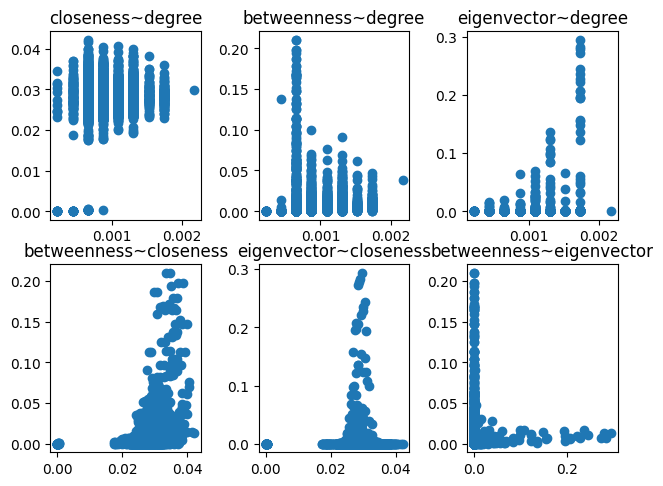

In [116]:
graphs = {}
graphs['New York'] = graph_NY
graphs['Manhattan'] = graph_MA
plot_centralities(graph_MA)

In [112]:
eigendict=eigenvector_centrality(graph_NY,max_iter=1000)

for node in top10:
    print(eigendict[node])

6.401491477706153e-17
1.941086300728748e-17
1.0899519019430292e-12
3.0335844922276657e-13
8.443224106049673e-14
2.2210771194826914e-15
6.184429227920772e-16
1.371052698543137e-11
3.815888028373513e-12
2.862461377166349e-17


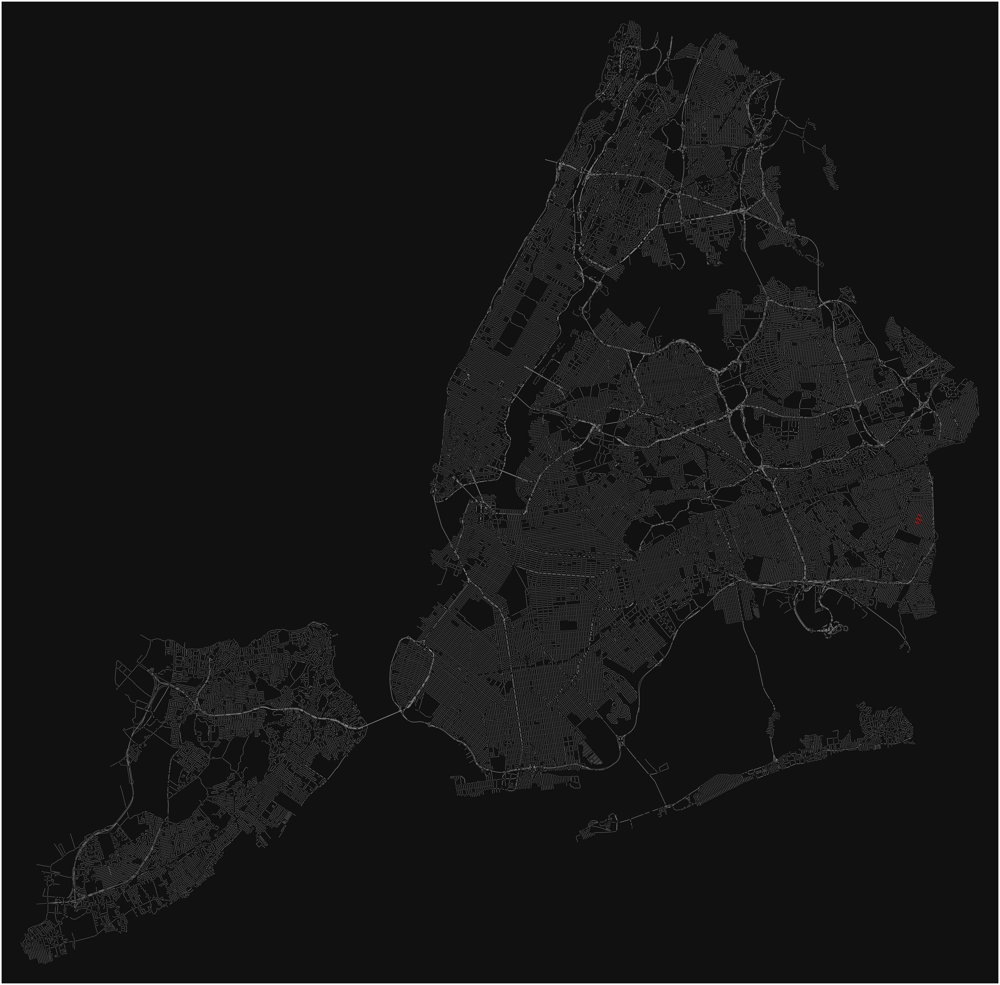

(<Figure size 8000x8000 with 1 Axes>, <AxesSubplot:>)

In [109]:
from heapq import nlargest
import pandas as pd
top10_eigen = nlargest(10,eigendict, key=eigendict.get)

important_nodes = set()
for node in top10_eigen:
    edge = dict(graph_NY[node]).keys()
    for e in edge:
        #print(graph[node][e])
        try:
            important_nodes.add(graph_NY[node][e]["name"])
        except:
            pass
node_colors = {}
for node in uncleaned_graph_NY.nodes:
    if str(node) in top10_eigen:
        color = (1,0,0,1)
    else:
        color = (0,0,0,0.5)
        
    node_colors[node] = color
ox.plot_graph(uncleaned_graph_NY, node_color=pd.Series(node_colors),figsize=(80,80), node_size=30, save=True, filepath='top_1000_load_centrality.png')


In [58]:
print(f"graph density: {nx.density(graph_MA)}")
print(f"rand graph density: {nx.density(rand_graph_MA)}")


graph density: 0.0004663366887689598
rand graph density: 0.0004663366887689598


## average shortest path

In [149]:
LOAD=False
if LOAD:
    average_shortest_path = nx.average_shortest_path_length(graph)
else:
    with open('average_shortest_path.pickle', 'rb') as file:
        average_shortest_path = pickle.load(file)
print(average_shortest_path)

1396.2225092115373


In [110]:
import json
with open('load_centrality.json', 'r') as file:
    load_centrality = json.load(file)

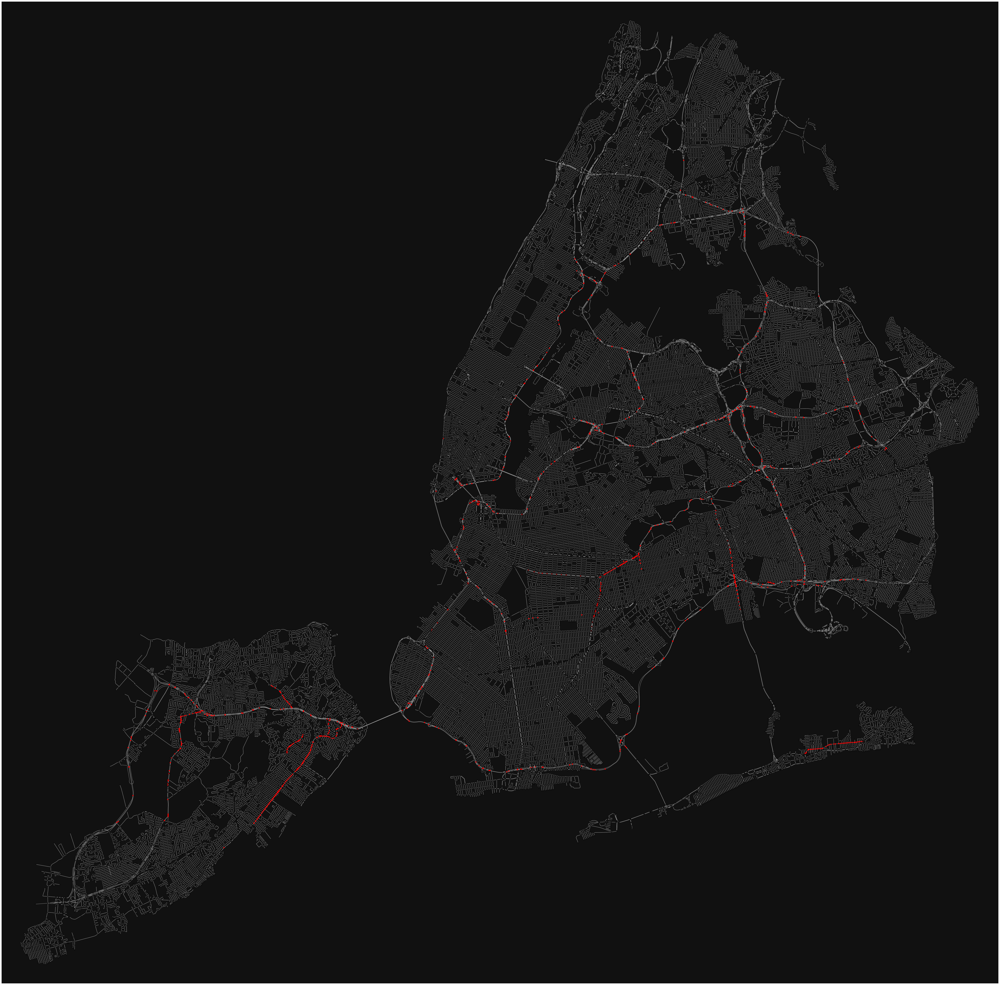

(<Figure size 8000x8000 with 1 Axes>, <AxesSubplot:>)

In [114]:
from heapq import nlargest
import pandas as pd
top10 = nlargest(1000,load_centrality, key=load_centrality.get)
important_nodes = set()
for node in top10:
    edge = dict(graph_NY[node]).keys()
    for e in edge:
        #print(graph[node][e])
        try:
            important_nodes.add(graph_NY[node][e]["name"])
        except:
            pass
node_colors = {}
for node in uncleaned_graph_NY.nodes:
    if str(node) in top10:
        color = (1,0,0,1)
    else:
        color = (0,0,0,0.5)
        
    node_colors[node] = color
ox.plot_graph(uncleaned_graph_NY, node_color=pd.Series(node_colors),figsize=(80,80), node_size=30, save=True, filepath='top_1000_load_centrality.png')


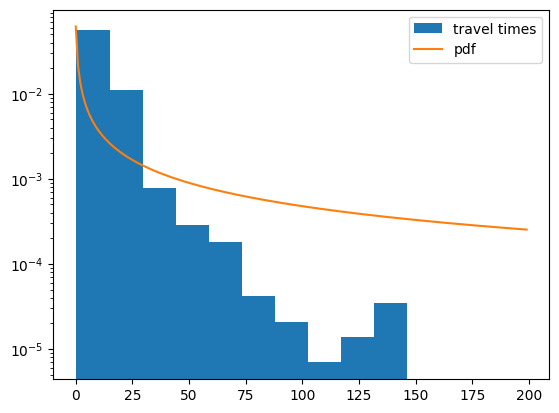

In [64]:
travel_times = []
for edge in graph_MA.edges:
    travel_times.append(graph_MA[edge[0]][edge[1]]['travel_time'])

    
mu = np.mean(travel_times)
sigma = np.std(travel_times)
count, bins, _ = plt.hist(travel_times, density=True, label="travel times")

x = np.linspace(min(bins), max(bins), 200)
pdf = (np.exp(-(np.log(x) - mu)**2 / (2 * sigma**2)) / (x * sigma * np.sqrt(2 * np.pi)))
plt.plot(pdf, label = "pdf")
plt.legend()
plt.yscale('log')
plt.show()

### 